In [34]:
import numpy as np
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
import skimage.feature
%matplotlib inline
import skimage.feature
import keras
from keras.models import Sequential, load_model
from keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, Lambda, Cropping2D
from keras.utils import np_utils

In [35]:
file_names = os.listdir("./raw_data_25/")
#file_names = sorted(file_names, key=lambda 
#                    item: (int(item.partition('.')[0]) if item[0].isdigit() else float('inf'), item))
# select a subset of files to run on
#file_names = file_names[0:2]

In [36]:
features = ["typical_colors", "non_typical_colors", "count"]
# dataframe to store results in
count_df = pd.DataFrame(index=file_names, columns=features).fillna(0)
count_df.head()

,typical_colors,non_typical_colors,count
20200520_194550_01.JPG,0,0,0
20200522_130013_01.JPG,0,0,0
20200527_143546_01.JPG,0,0,0
20200530_085518_01.JPG,0,0,0
20200602_161824_01.JPG,0,0,0


Get dot coordinates using blob_log from skimage library

In [37]:
coordinates_df = pd.DataFrame(index=file_names, columns=features)

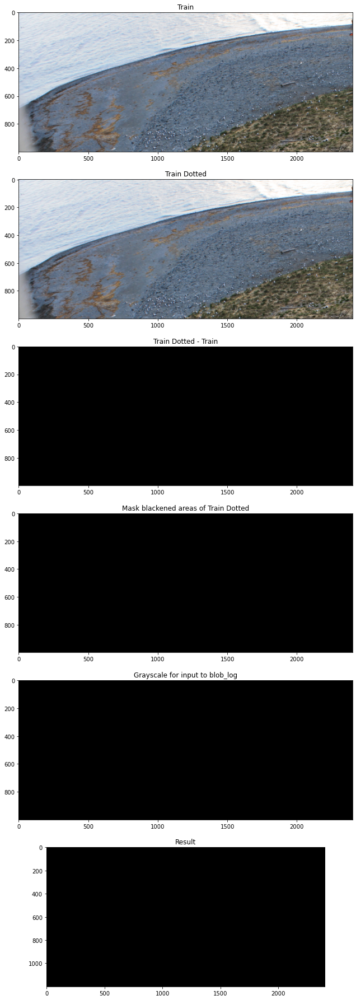

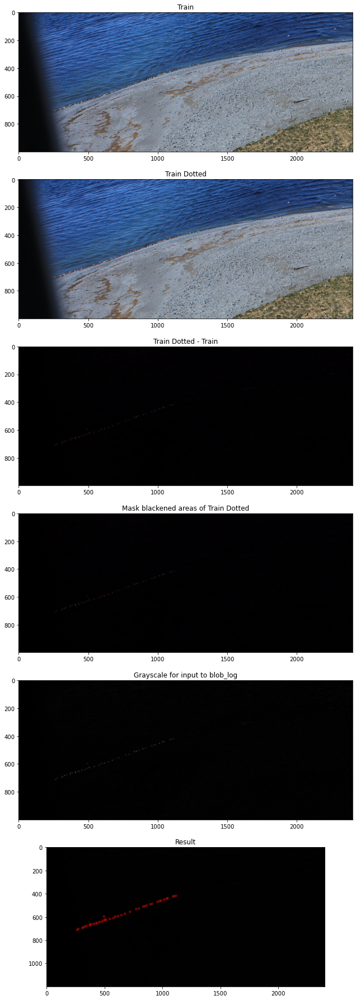

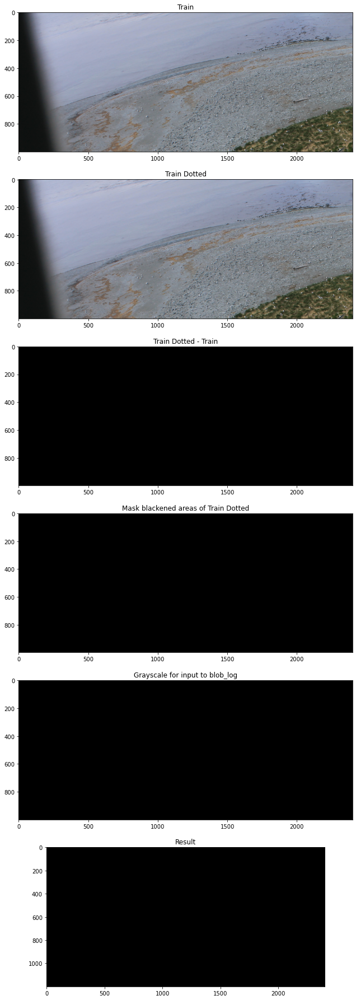

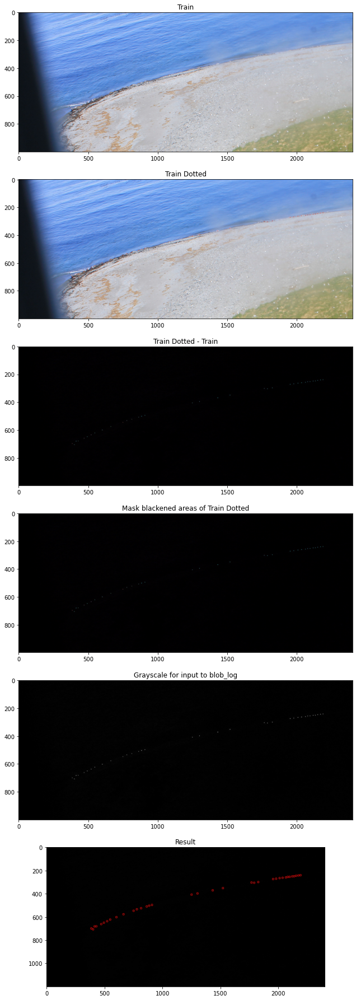

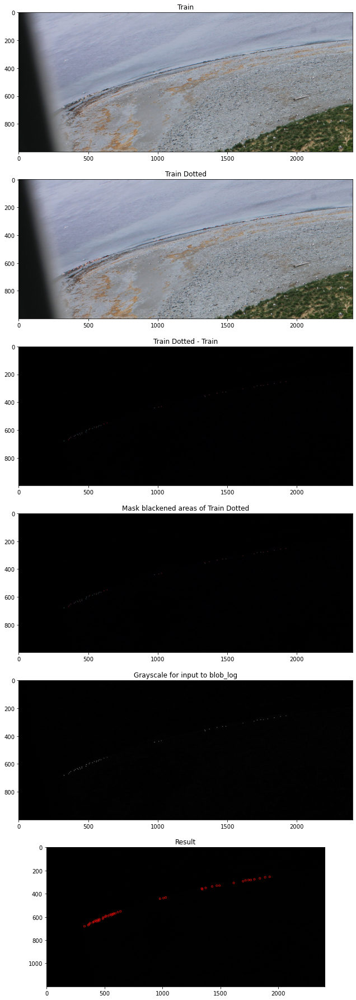

...

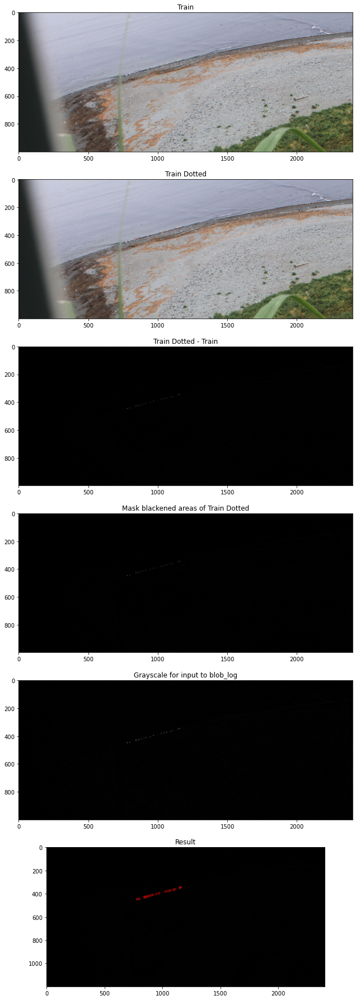

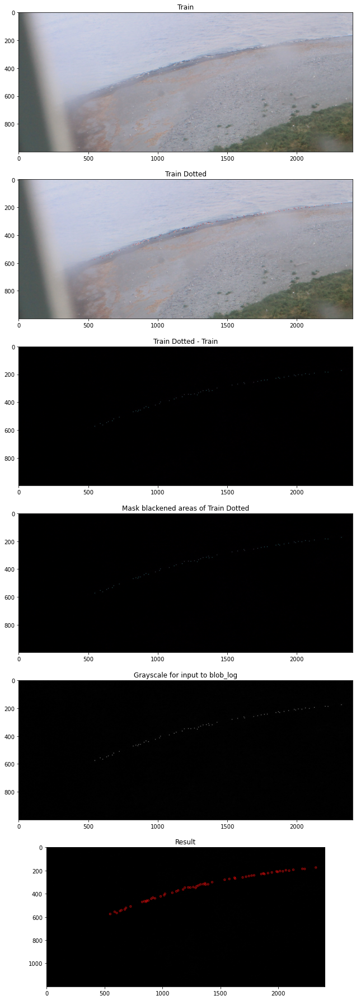

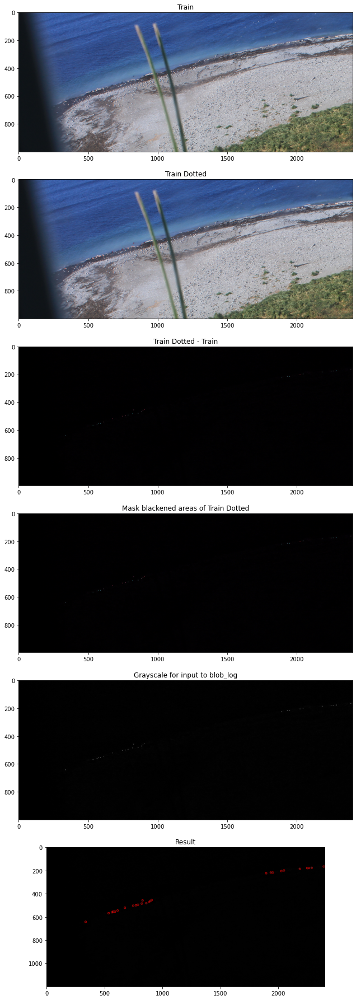

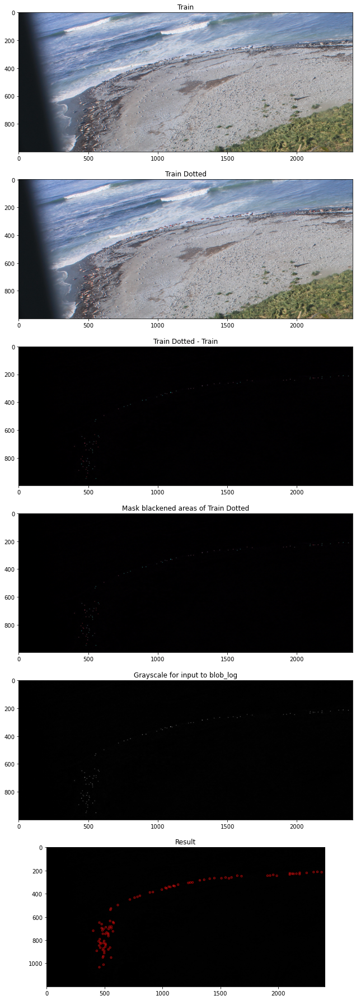

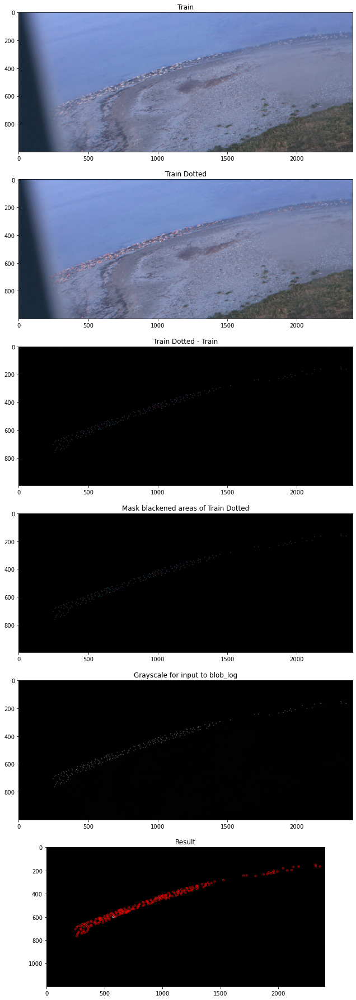

In [38]:
for filename in file_names:
    
    # read the Train and Train Dotted images
    image_1 = cv2.imread("./train_25/" + filename)
    image_2 = cv2.imread("./raw_data_25/" + filename)
    
    # absolute difference between Train and Train Dotted (точки)
    image_3 = cv2.absdiff(image_1,image_2)
    
    # mask out blackened regions from Train Dotted
    mask_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2GRAY)
    mask_1[mask_1 < 20] = 0
    mask_1[mask_1 > 0] = 255
    
    mask_2 = cv2.cvtColor(image_2, cv2.COLOR_BGR2GRAY)
    mask_2[mask_2 < 20] = 0
    mask_2[mask_2 > 0] = 255
    
    image_4 = cv2.bitwise_or(image_3, image_3, mask=mask_1)
    image_5 = cv2.bitwise_or(image_4, image_4, mask=mask_2) 
    
    # convert to grayscale to be accepted by skimage.feature.blob_log
    image_6 = cv2.cvtColor(image_5, cv2.COLOR_BGR2GRAY)
    
    # detect blobs
    blobs = skimage.feature.blob_log(image_6, min_sigma=3, max_sigma=4, num_sigma=1, threshold=0.02)
    
    seal = []
    
    
    # prepare the image to plot the results on
    image_7 = cv2.cvtColor(image_6, cv2.COLOR_GRAY2BGR)
    
    for blob in blobs:
        # get the coordinates for each blob
        y, x, s = blob
        # get the color of the pixel from Train Dotted in the center of the blob
        # img1 = cv2.GaussianBlur(image_1,(5,5),0) #optional
        b,g,r = image_1[int(y)][int(x)][:]
        
        # decision tree to pick the class of the blob by looking at the color in Train Dotted
        if r > 100 and b < 100 and g < 100: # Typical range of collors
            seal.append((int(x),int(y))) 
            count_df["typical_colors"][filename] += 1
            cv2.circle(image_7, (int(x),int(y)), 8, (0,0,255), 2)    
        else:
            seal.append((int(x),int(y)))
            count_df["non_typical_colors"][filename] += 1
            cv2.circle(image_7, (int(x),int(y)), 8, (255,255,255), 2)
    
    coordinates_df["count"][filename] = seal
    
    # sum all the results
    count_df['count'][filename] = count_df['typical_colors'][filename] + count_df['non_typical_colors'][filename]
    
    # output the results     
    f, ax = plt.subplots(6,1,figsize=(20,32))
    (ax1, ax2, ax3, ax4, ax5, ax6) = ax.flatten()
    plt.title('%s'%filename)
    
    ax1.imshow(cv2.cvtColor(image_2[0:1000,0:2400,:], cv2.COLOR_BGR2RGB))
    ax1.set_title('Train')
    ax2.imshow(cv2.cvtColor(image_1[0:1000,0:2400,:], cv2.COLOR_BGR2RGB))
    ax2.set_title('Train Dotted')
    ax3.imshow(cv2.cvtColor(image_3[0:1000,0:2400,:], cv2.COLOR_BGR2RGB))
    ax3.set_title('Train Dotted - Train')
    ax4.imshow(cv2.cvtColor(image_5[0:1000,0:2400,:], cv2.COLOR_BGR2RGB))
    ax4.set_title('Mask blackened areas of Train Dotted')
    ax5.imshow(image_6[0:1000,0:2400], cmap='gray')
    ax5.set_title('Grayscale for input to blob_log')
    ax6.imshow(cv2.cvtColor(image_7[0:1200,0:2400,:], cv2.COLOR_BGR2RGB))
    ax6.set_title('Result')

    plt.show()

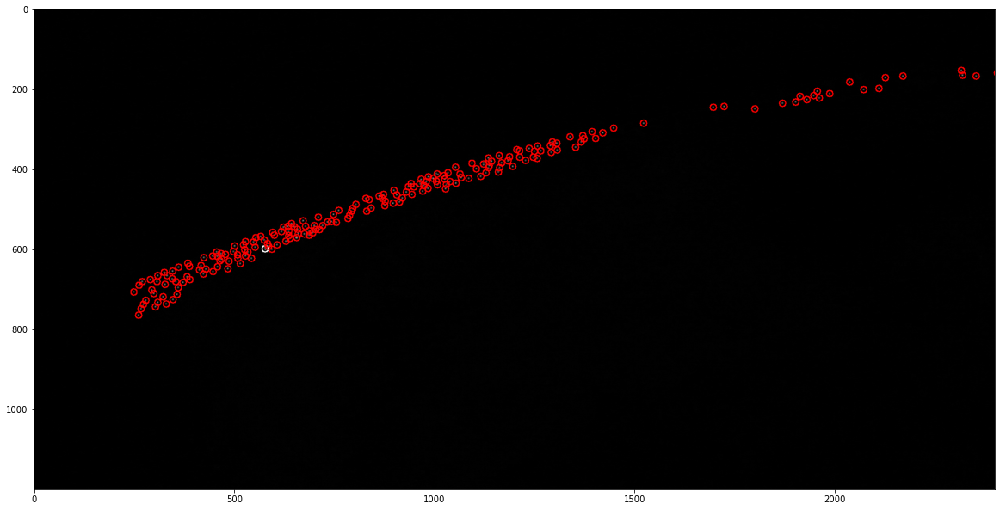

In [42]:
plt.figure(figsize=(20,32))
imgplot = plt.imshow(cv2.cvtColor(image_7[0:1200,0:2400,:], cv2.COLOR_BGR2RGB))

In [43]:
count_df

,typical_colors,non_typical_colors,count
20200520_194550_01.JPG,0,0,0
20200522_130013_01.JPG,41,0,41
20200527_143546_01.JPG,0,0,0
20200530_085518_01.JPG,35,0,35
20200602_161824_01.JPG,43,0,43
20200605_194028_01.JPG,7,0,7
20200609_050440_01.JPG,74,0,74
20200612_072611_01.JPG,88,0,88
20200613_133500_01.JPG,3,0,3
20200616_135613_01.JPG,0,0,0


In [44]:
coordinates_df["typical_colors"] = count_df["typical_colors"]
coordinates_df["non_typical_colors"] = count_df["non_typical_colors"]

In [45]:
coordinates_df

,typical_colors,non_typical_colors,count
20200520_194550_01.JPG,0,0,[]
20200522_130013_01.JPG,41,0,"[(846, 508), (1043, 439), (331, 683), (410, 66..."
20200527_143546_01.JPG,0,0,[]
20200530_085518_01.JPG,35,0,"[(1431, 371), (414, 682), (884, 503), (2033, 2..."
20200602_161824_01.JPG,43,0,"[(488, 604), (327, 681), (485, 616), (977, 443..."
20200605_194028_01.JPG,7,0,"[(584, 584), (804, 504), (481, 650), (642, 561..."
20200609_050440_01.JPG,74,0,"[(1617, 315), (818, 538), (1342, 368), (1405, ..."
20200612_072611_01.JPG,88,0,"[(1589, 309), (1660, 300), (751, 511), (1550, ..."
20200613_133500_01.JPG,3,0,"[(806, 471), (411, 706), (495, 656)]"
20200616_135613_01.JPG,0,0,[]


In [72]:
x = []
y = []
for filename in file_names:    
    image = cv2.imread("./raw_data_25/" + filename)
    
    for coordinates in coordinates_df['count'][filename]:
        thumb = image[coordinates[1]-8:coordinates[1]+8,coordinates[0]-8:coordinates[0]+8,:]
        if np.shape(thumb) == (16, 16, 3):
            x.append(thumb)
    y.append(coordinates_df['typical_colors'][filename])
x = np.array(x)
y = np.array(y)

In [73]:
x.shape

(1195, 16, 16, 3)

In [74]:
x

array([[[[140,  97,  64],
         [135,  92,  59],
         [119,  80,  48],
         ...,
         [ 94,  72,  66],
         [ 95,  77,  76],
         [ 99,  85,  89]],

        [[117,  81,  57],
         [107,  74,  54],
         [ 96,  65,  44],
         ...,
         [ 99,  83,  77],
         [101,  87,  88],
         [113, 100, 102]],

        [[ 97,  74,  66],
         [ 86,  66,  61],
         [ 65,  46,  43],
         ...,
         [106,  93,  91],
         [115, 106, 103],
         [131, 122, 119]],

        ...,

        [[ 71,  70,  90],
         [ 74,  74,  92],
         [133, 134, 144],
         ...,
         [135, 126, 129],
         [146, 138, 139],
         [153, 140, 142]],

        [[109, 109, 123],
         [106, 105, 115],
         [132, 130, 129],
         ...,
         [129, 120, 123],
         [149, 139, 139],
         [159, 145, 146]],

        [[139, 137, 143],
         [132, 127, 128],
         [149, 141, 134],
         ...,
         [146, 135, 137],
        

In [75]:
y.shape

(25,)

In [76]:
y

array([  0,  41,   0,  35,  43,   7,  74,  88,   3,   0,  62,   0,  51,
         0,  24,   0,   0,   0,   0, 215,  66,  61,  41, 111, 271],
      dtype=int64)

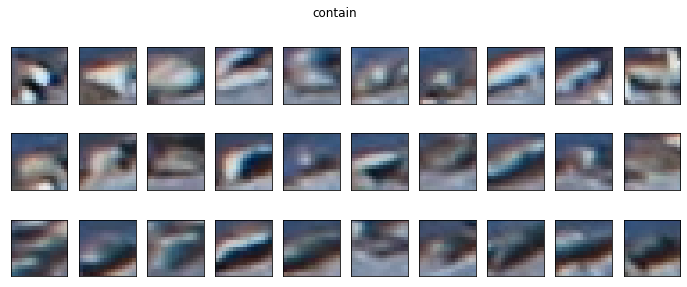

In [51]:
f, ax = plt.subplots(3,10,figsize=(12,4.5))
f.suptitle('contain')
axes = ax.flatten()
j = 0
for a in axes:
    a.set_xticks([])
    a.set_yticks([])
    for i in range(j,len(x)):
        if y[i] == 1:
            j = i+1
            a.imshow(cv2.cvtColor(x[i], cv2.COLOR_BGR2RGB))
            break

In [30]:
model = Sequential()

model.add(Lambda(lambda x: (x / 255.0) - 0.5, input_shape=(16,16,3)))


model.add(Conv2D(32, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Conv2D(64, (3, 3), activation='relu', padding='same'))

model.add(Flatten())

model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1, activation='softmax'))

model.compile(loss='binary_crossentropy',optimizer='adam',metrics=['accuracy'])

In [31]:
from sklearn.model_selection import train_test_split

In [32]:
history = model.fit(x, y, epochs=20, validation_split=0.2, verbose=0)

In [78]:
result = model.predict(x)
print('Training set --')
print('    ground truth: ', np.sum(y, axis=0))
print('  evaluate count: ', np.sum(result, axis=0).astype('int'))

Training set --
    ground truth:  1193
  evaluate count:  [1195]


In [80]:
test_dir_names = os.listdir("./test_25/")

In [82]:
for filename in test_dir_names:
    image_test = cv2.imread("./test_25/" + filename)

In [85]:
test_df = pd.DataFrame(index=file_names, columns=features)
test_df.head()

,typical_colors,non_typical_colors,count
20200520_194550_01.JPG,NaN,NaN,NaN
20200522_130013_01.JPG,NaN,NaN,NaN
20200527_143546_01.JPG,NaN,NaN,NaN
20200530_085518_01.JPG,NaN,NaN,NaN
20200602_161824_01.JPG,NaN,NaN,NaN


In [88]:
image_test = cv2.imread("./test_25/20200520_194550_01.JPG")

In [90]:
result_1 = model.predict(image_test)

ValueError: Failed to find data adapter that can handle input: <class 'NoneType'>, <class 'NoneType'>